# 빅데이터 분석 (5주차) 10월12일
> 손실함수의 비교, Adam, universal approximation theorem, MNIST with MLP

- toc:true
- branch: master
- badges: true
- comments: false
- author: 최서연
- categories: [Big Data Analysis, Pytorch, 손실함수의 비교, Adam, universal approximation theorem, MNIST with MLP]

## MSEloss 와 BCEloss 비교

### 손실함수의 모양비교

In [1]:
import torch
import numpy as np
import matplotlib.pyplot as plt

In [9]:
torch.manual_seed(1)
X=torch.linspace(-1,1,2000).reshape(2000,1)
w0=-1.0
w1=5.0
u=w0+X*w1
v=torch.exp(u)/(1+torch.exp(u))
y=torch.bernoulli(v)

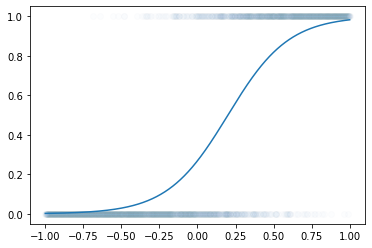

In [12]:
plt.scatter(X,y,alpha=0.01)
plt.plot(X,v)

In [15]:
_w0=np.arange(-10,3,0.05)
_w1=np.arange(-1,10,0.05)

In [16]:
_w0.shape,_w1.shape

((260,), (220,))

In [17]:
_w0,_w1=np.meshgrid(_w0,_w1,indexing='ij') # grid를 array로 만들기

In [20]:
_w0.shape,_w1.shape

((260, 220), (260, 220))

In [21]:
_w0=_w0.reshape(-1) # x,y를 곱하기
_w1=_w1.reshape(-1)

In [22]:
_w0.shape,_w1.shape

((57200,), (57200,))

In [45]:
def lossfn_crossenp(w0,w1): 
    yhat=torch.exp( w0+w1*X) / (1+torch.exp( w0+w1*X))
    loss= - torch.mean (y*torch.log(yhat)+(1-y)*torch.log(1-yhat)) 
    return loss.tolist()

In [46]:
def lossfn_mse(w0,w1): 
    yhat=torch.exp( w0+w1*X) / (1+torch.exp( w0+w1*X))
    loss= torch.mean((y-yhat)**2) 
    return loss.tolist()

In [47]:
_l1=list(map(lossfn_crossenp,_w0,_w1))
_l2=list(map(lossfn_mse,_w0,_w1))

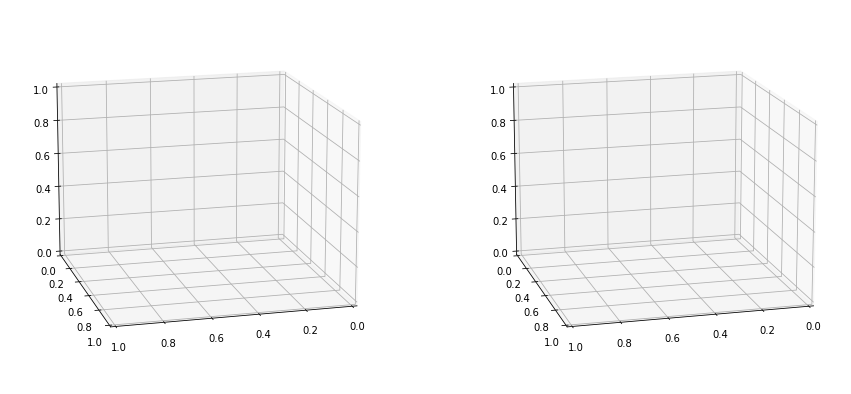

In [48]:
fig=plt.figure()
ax1=fig.add_subplot(1,2,1,projection='3d')
ax2=fig.add_subplot(1,2,2,projection='3d')
ax1.elev=15
ax2.elev=15
ax1.azim=75
ax2.azim=75
fig.set_figheight(15)
fig.set_figwidth(15)

In [49]:
ax1.scatter(_w0,_w1,_l1,s=0.01)
ax2.scatter(_w0,_w1,_l2,s=0.01)

In [51]:
_w0[np.argmin(_l1)],_w1[np.argmin(_l1)] # 실제 값이랑 비슷

(-0.9999999999998721, 5.150000000000006)

In [52]:
_w0[np.argmin(_l2)],_w1[np.argmin(_l2)] # 실제 값이랑 비슷

(-0.9999999999998721, 5.100000000000005)

In [61]:
ax1.scatter(_w0[np.argmin(_l1)],_w1[np.argmin(_l1)],np.min(_l1),s=200,marker='*')
ax2.scatter(_w0[np.argmin(_l2)],_w1[np.argmin(_l2)],np.min(_l2),s=200,marker='*')

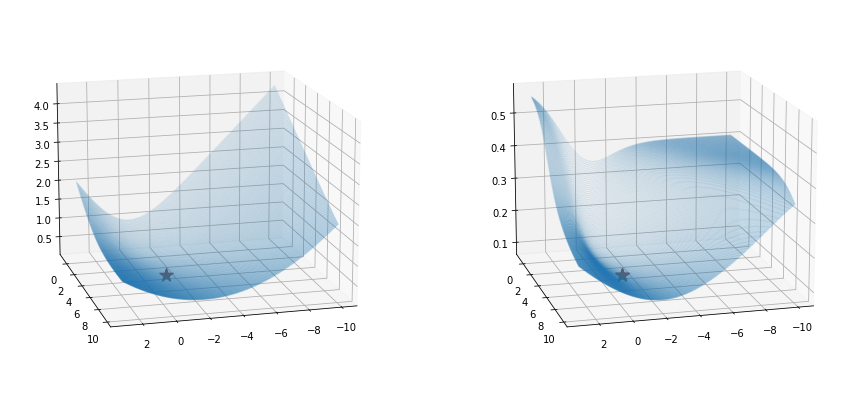

In [62]:
fig

- crossentrop(왼)이 mse(오른)보다 최소값 찾기 쉬워보이는 모형
- convex란 아래로 볼록한 2차 곡선 모양을 뜻함


- 오른쪽꺼 단면을 자르게 되면 평면이 나오는 현상이 나올 수도 있다.(오른쪽 대각선 부분)
- logistic의 경우 mse가 아니라 **Bionary Cross Entropy**로 하면 convex를 만날 수 있다.
- **MLE 이기 때문에 BCE를 써야 한다고 말할 수도 있다.**

### 아키텍처, 옵티마이저 

In [115]:
l1=torch.nn.Linear(in_features=1,out_features=1,bias=True)
a1=torch.nn.Sigmoid()
net=torch.nn.Sequential(l1,a1) 
optimizer=torch.optim.SGD(net.parameters(),lr=0.05) 

### 초기값 $(w_0,w_1)=(-3,-1)$을 대입하고 수렴과정을 animation으로 관찰하자. 

`-` 파라메터 초기값 $(w_0,w_1)=(-3,-1)$로 설정 

In [125]:
l1.bias.data, l1.weight.data

(tensor([-3.]), tensor([-1.]))

In [126]:
l1.bias.data=torch.tensor([-3.0])
l1.weight.data=torch.tensor([[-1.0]]) 

In [127]:
l1.bias.data, l1.weight.data

(tensor([-3.]), tensor([[-1.]]))

`-` BCEloss를 이용하여 학습+기록 

In [128]:
w0_bce=[] 
w1_bce=[]
loss_bce=[]
for epoc in range(1000): 
    ## 1 
    yhat=net(X) 
    ## 2 
    loss= - torch.mean(y*torch.log(yhat) + (1-y)*torch.log(1-yhat)) 
    ## 3 
    loss.backward()
    ## 4 
    optimizer.step()
    net.zero_grad()
    ## 5 
    if epoc%20 == 0: 
        w0_bce.append(l1.bias.data.item())
        w1_bce.append(l1.weight.data.item())
        loss_bce.append(loss.item())

In [129]:
l1.bias.data,l1.weight.data

(tensor([-0.6726]), tensor([[3.3696]]))

`-` 파라메터 초기값 $(w_0,w_1)=(-3,-1)$로 설정 

In [130]:
l1.bias.data,l1.weight.data

(tensor([-0.6726]), tensor([[3.3696]]))

In [131]:
l1.bias.data=torch.tensor([-3.0])
l1.weight.data=torch.tensor([[-1.0]])

In [132]:
l1.bias.data,l1.weight.data

(tensor([-3.]), tensor([[-1.]]))

`-` MSEloss를 이용하여 학습+기록 

In [133]:
w0_mse=[] 
w1_mse=[]
loss_mse=[]
for epoc in range(1000): 
    ## 1 
    yhat=net(X) 
    ## 2 
    loss= torch.mean((y-yhat)**2)
    ## 3 
    loss.backward()
    ## 4 
    optimizer.step()
    net.zero_grad()
    ## 5 
    if epoc%20 == 0: 
        w0_mse.append(l1.bias.data.item())
        w1_mse.append(l1.weight.data.item())
        loss_mse.append(loss.item())

In [134]:
l1.bias.data,l1.weight.data

(tensor([-0.9688]), tensor([[0.7116]]))

`-` plot

In [137]:
from matplotlib import animation
plt.rcParams["animation.html"] = "jshtml"

In [138]:
### figsetting 
fig = plt.figure()
ax1= fig.add_subplot(2,2,1,projection='3d')
ax2= fig.add_subplot(2,2,2,projection='3d')
ax3= fig.add_subplot(2,2,3)
ax4= fig.add_subplot(2,2,4)
ax1.elev = 15
ax2.elev = 15
ax1.azim = 75
ax2.azim = 75
fig.set_figheight(15)
fig.set_figwidth(15)

### init plot 
ax1.scatter(_w0,_w1,_l1,s=0.05)
ax2.scatter(_w0,_w1,_l2,s=0.05)
ax1.scatter(-3,-1,lossfn_crossenp(-3,-1),color='gray') ## bceloss(binary cross entropy loss)
ax1.scatter(-1,5.1,lossfn_crossenp(-1,5.1),s=200,color='red',marker='*') ## bceloss
ax2.scatter(-3,-1,lossfn_mse(-3,-1),color='gray') ## mseloss 
ax2.scatter(-1,5.1,lossfn_mse(-1,5.1),s=200,color='red',marker='*') ## mseloss
ax3.scatter(X,y,alpha=0.01)
ax3.plot(X,v,'--')
line3, = ax3.plot(X,1/(1+torch.exp(-w0_bce[0]-w1_bce[0]*X)),'--')
ax4.scatter(X,y,alpha=0.01)
ax4.plot(X,v,'--')
line4, = ax4.plot(X,1/(1+torch.exp(-w0_mse[0]-w1_mse[0]*X)),'--')


### animation 
def animate(i):
    ax1.scatter(w0_bce[i],w1_bce[i],lossfn_crossenp(w0_bce[i],w1_bce[i]),color='gray')
    ax2.scatter(w0_mse[i],w1_mse[i],lossfn_mse(w0_mse[i],w1_mse[i]),color='gray')
    line3.set_ydata(1/(1+torch.exp(-w0_bce[i]-w1_bce[i]*X)))
    line4.set_ydata(1/(1+torch.exp(-w0_mse[i]-w1_mse[i]*X)))
    return line3,line4

ani = animation.FuncAnimation(fig, animate, frames=50)
plt.close()
ani

### 초기값 $(w_0,w_1)=(-10,-1)$을 대입하고 수렴과정을 animation으로 관찰하자. 

`-` 파라메터 초기값 $(w_0,w_1)=(-10,-1)$로 설정 

In [139]:
l1.bias.data, l1.weight.data

(tensor([-0.9688]), tensor([[0.7116]]))

In [140]:
l1.bias.data=torch.tensor([-10.0])
l1.weight.data=torch.tensor([[-1.0]])

In [141]:
l1.bias.data, l1.weight.data

(tensor([-10.]), tensor([[-1.]]))

`-` BCEloss를 이용하여 학습+기록 

In [142]:
w0_bce=[] 
w1_bce=[]
loss_bce=[]
for epoc in range(1000): 
    ## 1 
    yhat=net(X) 
    ## 2 
    loss= - torch.mean(y*torch.log(yhat) + (1-y)*torch.log(1-yhat)) 
    ## 3 
    loss.backward()
    ## 4 
    optimizer.step()
    net.zero_grad()
    ## 5 
    if epoc%20 == 0: 
        w0_bce.append(l1.bias.data.item())
        w1_bce.append(l1.weight.data.item())
        loss_bce.append(loss.item())

In [143]:
l1.bias.data, l1.weight.data

(tensor([-0.8302]), tensor([[4.0264]]))

`-` 파라메터 초기값 $(w_0,w_1)=(-10,-1)$로 설정 

In [144]:
l1.bias.data, l1.weight.data

(tensor([-0.8302]), tensor([[4.0264]]))

In [150]:
l1.bias.data=torch.tensor([-10.0])
l1.weight.data=torch.tensor([[-1.0]])

In [151]:
l1.bias.data, l1.weight.data

(tensor([-10.]), tensor([[-1.]]))

`-` MSEloss를 이용하여 학습+기록 

In [152]:
w0_mse=[] 
w1_mse=[]
loss_mse=[]
for epoc in range(1000): 
    ## 1 
    yhat=net(X) 
    ## 2 
    loss= torch.mean((y-yhat)**2)
    ## 3 
    loss.backward()
    ## 4 
    optimizer.step()
    net.zero_grad()
    ## 5 
    if epoc%20 == 0: 
        w0_mse.append(l1.bias.data.item())
        w1_mse.append(l1.weight.data.item())
        loss_mse.append(loss.item())

In [153]:
l1.bias.data, l1.weight.data

(tensor([-9.9990]), tensor([[-0.9995]]))

`-` plot

In [154]:
### figsetting 
fig = plt.figure()
ax1= fig.add_subplot(2,2,1,projection='3d')
ax2= fig.add_subplot(2,2,2,projection='3d')
ax3= fig.add_subplot(2,2,3)
ax4= fig.add_subplot(2,2,4)
ax1.elev = 15
ax2.elev = 15
ax1.azim = 75
ax2.azim = 75
fig.set_figheight(15)
fig.set_figwidth(15)

### init plot 
ax1.scatter(_w0,_w1,_l1,s=0.05)
ax2.scatter(_w0,_w1,_l2,s=0.05)
ax1.scatter(-10,-1,lossfn_crossenp(-10,-1),color='gray') ## bceloss
ax1.scatter(-1,5.1,lossfn_crossenp(-1,5.1),s=200,color='red',marker='*') ## bceloss
ax2.scatter(-10,-1,lossfn_mse(-10,-1),color='gray') ## mseloss 
ax2.scatter(-1,5.1,lossfn_mse(-1,5.1),s=200,color='red',marker='*') ## mseloss
ax3.scatter(X,y,alpha=0.01)
ax3.plot(X,v,'--')
line3, = ax3.plot(X,1/(1+torch.exp(-w0_bce[0]-w1_bce[0]*X)),'--')
ax4.scatter(X,y,alpha=0.01)
ax4.plot(X,v,'--')
line4, = ax4.plot(X,1/(1+torch.exp(-w0_mse[0]-w1_mse[0]*X)),'--')


### animation 
def animate(i):
    ax1.scatter(w0_bce[i],w1_bce[i],lossfn_crossenp(w0_bce[i],w1_bce[i]),color='gray')
    ax2.scatter(w0_mse[i],w1_mse[i],lossfn_mse(w0_mse[i],w1_mse[i]),color='gray')
    line3.set_ydata(1/(1+torch.exp(-w0_bce[i]-w1_bce[i]*X)))
    line4.set_ydata(1/(1+torch.exp(-w0_mse[i]-w1_mse[i]*X)))
    return line3,line4

ani = animation.FuncAnimation(fig, animate, frames=50)
plt.close()
ani

- 모든 모형에 대해서 convex 모형을 찾을 수 있을까?
- MSE/ BCE 를 어느 상황에 써야할지 알아야 하는데, 모든 모형에서 항상 convex한 loss를 찾을 수 없다.
- 모형이 복잡해질 수록 최저점을 찾기 어려워. loss 함수 모양이 복잡해질테니까.
- loss 함수 모형을 바꾸는 접근법과, 그 상황에서 loss를 찾아가는 방법, 즉 optimizer를 만들어보자는 접근법이 있다.


- 왼쪽 그림보고 드는 생각
    - 경사가 있는 쪽은 학습률을 느리게, 경사가 완만하면 학습률을 빠르게 하고 싶다.
    - 경사하강법
        - 1. 편미분(한 축 고정 한 축 움직임)은 x축이 많이 움직일수도, y축이 많이 움직일 수도 있잖아? 그래서 많이 움직이고 싶은 때! **변화폭에 따라 학습률 조정**
            - 하지만 이 방법으로는 평면(단면이)일때 미분이 불가할 수도 있다.
        - 2. 미세하지만 잡히는 평면같은 곳의 기울기의 **운동량,momentum** 개념을 도입해서
            - 가속도를 가지고 누적하여 점점 큰 폭으로 움직이라는 명령과 함께 움직임
        - 3. 이 두 가지를 합쳐 만든게 **Adam**!

### Adam 옵티마이저, $(w_0,w_1)=(-3,-1)$

`-` 옵티마이저 재설정 

In [155]:
optimizer=torch.optim.Adam(net.parameters(),lr=0.05) # 학습률은 같게 조정(비교를 위해)

`-` 파라메터 초기값 $(w_0,w_1)=(-3,-1)$로 설정 

In [156]:
l1.bias.data, l1.weight.data

(tensor([-9.9990]), tensor([[-0.9995]]))

In [157]:
l1.bias.data=torch.tensor([-3.0])
l1.weight.data=torch.tensor([[-1.0]])

In [158]:
l1.bias.data, l1.weight.data

(tensor([-3.]), tensor([[-1.]]))

`-` BCEloss를 사용하여 학습 + 기록 

In [159]:
w0_bce=[] 
w1_bce=[]
loss_bce=[]
for epoc in range(1000): 
    ## 1 
    yhat=net(X) 
    ## 2 
    loss= - torch.mean(y*torch.log(yhat) + (1-y)*torch.log(1-yhat)) 
    ## 3 
    loss.backward()
    ## 4 
    optimizer.step()
    net.zero_grad()
    ## 5 
    if epoc%20 == 0: 
        w0_bce.append(l1.bias.data.item())
        w1_bce.append(l1.weight.data.item())
        loss_bce.append(loss.item())

In [160]:
l1.bias.data, l1.weight.data

(tensor([-1.0201]), tensor([[5.1584]]))

`-` 파라메터 초기값 $(w_0,w_1)=(-3,-1)$로 설정 

In [161]:
l1.bias.data, l1.weight.data

(tensor([-1.0201]), tensor([[5.1584]]))

In [162]:
l1.bias.data=torch.tensor([-3.0])
l1.weight.data=torch.tensor([[-1.0]])

In [163]:
l1.bias.data, l1.weight.data

(tensor([-3.]), tensor([[-1.]]))

`-` MSEloss를 사용하여 학습+기록

In [164]:
w0_mse=[] 
w1_mse=[]
loss_mse=[]
for epoc in range(1000): 
    ## 1 
    yhat=net(X) 
    ## 2 
    loss= torch.mean((y-yhat)**2)
    ## 3 
    loss.backward()
    ## 4 
    optimizer.step()
    net.zero_grad()
    ## 5 
    if epoc%20 == 0: 
        w0_mse.append(l1.bias.data.item())
        w1_mse.append(l1.weight.data.item())
        loss_mse.append(loss.item())

In [165]:
l1.bias.data, l1.weight.data

(tensor([-0.9995]), tensor([[5.0790]]))

In [ ]:
### figsetting 
fig = plt.figure()
ax1= fig.add_subplot(2,2,1,projection='3d')
ax2= fig.add_subplot(2,2,2,projection='3d')
ax3= fig.add_subplot(2,2,3)
ax4= fig.add_subplot(2,2,4)
ax1.elev = 15
ax2.elev = 15
ax1.azim = 75
ax2.azim = 75
fig.set_figheight(15)
fig.set_figwidth(15)

### init plot 
ax1.scatter(_w0,_w1,_l1,s=0.05)
ax2.scatter(_w0,_w1,_l2,s=0.05)
ax1.scatter(-3,-1,lossfn_crossenp(-3,-1),color='gray') ## bceloss
ax1.scatter(-1,5.1,lossfn_crossenp(-1,5.1),s=200,color='red',marker='*') ## bceloss
ax2.scatter(-3,-1,lossfn_mse(-3,-1),color='gray') ## mseloss 
ax2.scatter(-1,5.1,lossfn_mse(-1,5.1),s=200,color='red',marker='*') ## mseloss
ax3.scatter(X,y,alpha=0.01)
ax3.plot(X,v,'--')
line3, = ax3.plot(X,1/(1+torch.exp(-w0_bce[0]-w1_bce[0]*X)),'--')
ax4.scatter(X,y,alpha=0.01)
ax4.plot(X,v,'--')
line4, = ax4.plot(X,1/(1+torch.exp(-w0_mse[0]-w1_mse[0]*X)),'--')


### animation 
def animate(i):
    ax1.scatter(w0_bce[i],w1_bce[i],lossfn_crossenp(w0_bce[i],w1_bce[i]),color='gray')
    ax2.scatter(w0_mse[i],w1_mse[i],lossfn_mse(w0_mse[i],w1_mse[i]),color='gray')
    line3.set_ydata(1/(1+torch.exp(-w0_bce[i]-w1_bce[i]*X)))
    line4.set_ydata(1/(1+torch.exp(-w0_mse[i]-w1_mse[i]*X)))
    return line3,line4

ani = animation.FuncAnimation(fig, animate, frames=50)
plt.close()
ani